# Data preparation

Import libraries

In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder, Caltech101
from torch.utils.data import DataLoader, random_split
import os
from imutils import paths
import numpy as np
from tqdm import tqdm
import cv2

Unarchive dataset

In [4]:
import tarfile
import os

# Extract the compressed dataset
dataset_path = './Caltech101Dataset/caltech-101/101_ObjectCategories.tar.gz'
extracted_folder_path = './Caltech101Dataset/'
if not os.path.exists(extracted_folder_path + '101_ObjectCategories'):
    with tarfile.open(dataset_path, 'r:gz') as tar:
        tar.extractall(extracted_folder_path)

In [2]:
# Check if CUDA (GPU support) is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)
print(f'The Colab is using {torch.cuda.get_device_name(device)} GPU')

Using device: cuda
The Colab is using NVIDIA GeForce GTX 1650 GPU


Among the many categories available in the dataset, we will select all but one called "BACKGROUND_Google" because it does not contain homogeneous objects that could be deciphered

In [7]:
# Preparing the Labels and Images
image_paths = list(paths.list_images('./Caltech101Dataset/101_ObjectCategories'))

data = []
labels = []
for img_path in tqdm(image_paths):
    label = img_path.split(os.path.sep)[-2]
    if label == "BACKGROUND_Google":
        continue
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (224, 224))  # Resize the image to a consistent size
    
    data.append(img)
    labels.append(label)
    
data = np.array(data)
labels = np.array(labels)

# Print the shapes to verify
print("Data shape:", data.shape)
print("Labels shape:", labels.shape)

100%|██████████| 9144/9144 [00:22<00:00, 403.74it/s] 


Data shape: (8677, 224, 224, 3)
Labels shape: (8677,)


In [8]:
from sklearn.preprocessing import LabelEncoder

lb = LabelEncoder()
labels = lb.fit_transform(labels)
print(f"Total Number of Classes: {len(lb.classes_)}")

Total Number of Classes: 101


Let's divide the initial dataset into training and validation, in a ratio of 7:3

In [9]:
from sklearn.model_selection import train_test_split

# Divide the raw dataset into train and test sets
x_train, x_test, y_train, y_test = train_test_split(data, labels, test_size=0.3)

# Print the shapes to verify
print(f"x_train examples: {len(x_train)}\nx_test examples: {len(x_test)}")

x_train examples: 6073
x_test examples: 2604


In [10]:
from torchvision import transforms

transforms = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean = [0.485,0.456,0.406], std=[0.229,0.224,0.225]),
])

In [11]:
from torch.utils.data import Dataset

class CustomDataset(Dataset):
    def __init__(self, data, labels, transform=None):
        self.data = data
        self.labels = labels
        self.transform = transform

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        image = self.data[idx]
        label = self.labels[idx]

        if self.transform:
            image = self.transform(image)

        return image, label

In [12]:
# Create custom datasets
train_dataset = CustomDataset(x_train, y_train, transforms)
test_dataset = CustomDataset(x_test, y_test, transforms)

# Create data loaders for training and testing sets
trainloader = DataLoader(train_dataset, batch_size=32, shuffle=True)
testloader = DataLoader(test_dataset, batch_size=32, shuffle=False)

# 1.1 Plain 3-layer CNN

In [24]:
import torch.nn.functional as F

In [45]:
class CNN(nn.Module):
    def __init__(self):
        super(CNN, self).__init__()
        self.conv1 = nn.Conv2d(3, 16, 3, padding=1)
        self.bn1 = nn.BatchNorm2d(16)
        self.conv2 = nn.Conv2d(16, 32, 3, padding=1)
        self.bn2 = nn.BatchNorm2d(32)
        self.conv3 = nn.Conv2d(32, 64, 3, padding=1)
        self.bn3 = nn.BatchNorm2d(64)
        self.dropout1 = nn.Dropout(0.25)
        self.dropout2 = nn.Dropout(0.375)
        self.dropout3 = nn.Dropout(0.5)
        self.fc1 = nn.Linear(64 * 28 * 28, 512)
        self.bn4 = nn.BatchNorm1d(512)
        self.fc2 = nn.Linear(512, 256)
        self.bn5 = nn.BatchNorm1d(256)
        self.fc3 = nn.Linear(256, 101)

    def forward(self, x):
        features = []
        x = self.conv1(x)
        x = self.bn1(x)
        x = F.relu(x)
        features.append(x)
        x = F.max_pool2d(x, 2)
        x = self.conv2(x)
        x = self.bn2(x)
        x = F.relu(x)
        features.append(x)
        x = F.max_pool2d(x, 2)
        x = self.conv3(x)
        x = self.bn3(x)
        x = F.relu(x)
        x = F.max_pool2d(x, 2)
        x = torch.flatten(x, 1)
        x = self.dropout1(x)
        x = self.fc1(x)
        x = self.bn4(x)
        x = F.relu(x)
        x = self.dropout2(x)
        x = self.fc2(x)
        x = self.bn5(x)
        x = F.relu(x)
        x = self.dropout3(x)
        x = self.fc3(x)
    
        return x, features

Let's write our own implementation of the functionality for EarlyStopping. This will give us an opportunity to save resources when the validation loss does not improve, relative to previous attempts, and we need to stop training.

In [28]:
import numpy as np
import torch

class EarlyStopping:
    """Early stops the training if validation loss doesn't improve after a given patience."""
    def __init__(self, patience=7, verbose=False, delta=0):
        """
        Args:
            patience (int): How long to wait after last time validation loss improved.
                            Default: 7
            verbose (bool): If True, prints a message for each validation loss improvement.
                            Default: False
            delta (float): Minimum change in the monitored quantity to qualify as an improvement.
                            Default: 0
        """
        self.patience = patience
        self.verbose = verbose
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.val_loss_min = np.Inf
        self.delta = delta

    def __call__(self, val_loss):
        score = -val_loss

        if self.best_score is None:
            self.best_score = score
            self.save_checkpoint(val_loss)
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.verbose:
                print(f'EarlyStopping counter: {self.counter} out of {self.patience}')
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.save_checkpoint(val_loss)
            self.counter = 0

        return self.early_stop

    def save_checkpoint(self, val_loss):
        '''Saves model when validation loss decrease.'''
        if self.verbose:
            print(f'Test loss decreased ({self.val_loss_min:.6f} --> {val_loss:.6f}).  Saving model ...')
        self.val_loss_min = val_loss


We train and test the CNN model. For optimal performance, Adam was selected as the optimizer and the learning_rate value was 0.0001

In [29]:
from sklearn.metrics import accuracy_score

In [ ]:
modelCNN = CNN().to(device)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(modelCNN.parameters(), lr=0.0001)

early_stopping = EarlyStopping(patience=3, verbose=True)

train_losses = []
test_losses = []
train_accuracies = []
test_accuracies = []

train_predicted_labels = []
train_ground_truth_labels = []
test_predicted_labels = []
test_ground_truth_labels = []
early_stopping_iteration = 0

for epoch in range(20):  
    modelCNN.train()
    running_loss = 0.0
    for inputs, labels in trainloader:
        inputs, labels = inputs.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = modelCNN(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()

        _, predicted = torch.max(outputs, 1)
        train_predicted_labels.extend(predicted.cpu().numpy())
        train_ground_truth_labels.extend(labels.cpu().numpy())

    train_loss = running_loss / len(trainloader)
    train_losses.append(train_loss)

    modelCNN.eval()
    correct = 0
    total = 0
    test_loss = 0.0
    with torch.no_grad():
        for inputs, labels in testloader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = modelCNN(inputs)
            loss = criterion(outputs, labels)
            test_loss += loss.item()
            _, predicted = torch.max(outputs, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

            test_predicted_labels.extend(predicted.cpu().numpy())
            test_ground_truth_labels.extend(labels.cpu().numpy())

    test_loss /= len(testloader)
    test_losses.append(test_loss)

    train_accuracy = accuracy_score(train_ground_truth_labels, train_predicted_labels)
    test_accuracy = accuracy_score(test_ground_truth_labels, test_predicted_labels)

    train_accuracies.append(train_accuracy)
    test_accuracies.append(test_accuracy)
    print(f"Epoch {epoch+1}: Train Loss: {train_loss:.4f}, Test Loss: {test_loss:.4f}")
    print(f'Train Accuracy: {train_accuracy * 100:.2f}%, Test Accuracy: {test_accuracy * 100:.2f}%')

    if early_stopping(test_loss):
        early_stopping_iteration = epoch
        print("Early stopping")
        break



results = {
    'train_losses': train_losses,
    'test_losses': test_losses,
    'train_accuracies': train_accuracies,
    'test_accuracies': test_accuracies,
    'early_stopping_epoch': early_stopping_iteration,
    'train_predicted_labels': train_predicted_labels,
    'train_ground_truth_labels': train_ground_truth_labels,
    'test_predicted_labels': test_predicted_labels,
    'test_ground_truth_labels': test_ground_truth_labels
}
torch.save(results, 'results.pth')

Epoch 1: Train Loss: 3.5990, Test Loss: 3.1567
Train Accuracy: 29.52%, Test Accuracy: 37.75%
Test loss decreased (inf --> 3.156685).  Saving model ...
Epoch 2: Train Loss: 2.8875, Test Loss: 2.8798
Train Accuracy: 35.33%, Test Accuracy: 39.96%
Test loss decreased (3.156685 --> 2.879825).  Saving model ...
Epoch 3: Train Loss: 2.5139, Test Loss: 2.6951
Train Accuracy: 39.81%, Test Accuracy: 42.23%
Test loss decreased (2.879825 --> 2.695116).  Saving model ...
Epoch 4: Train Loss: 2.2056, Test Loss: 2.5491
Train Accuracy: 43.90%, Test Accuracy: 43.88%
Test loss decreased (2.695116 --> 2.549086).  Saving model ...
Epoch 5: Train Loss: 1.9058, Test Loss: 2.4423
Train Accuracy: 48.17%, Test Accuracy: 45.51%
Test loss decreased (2.549086 --> 2.442264).  Saving model ...
Epoch 6: Train Loss: 1.6170, Test Loss: 2.3250
Train Accuracy: 52.39%, Test Accuracy: 46.95%
Test loss decreased (2.442264 --> 2.325016).  Saving model ...
Epoch 7: Train Loss: 1.3452, Test Loss: 2.2581
Train Accuracy: 56.56%

In [ ]:
import matplotlib.pyplot as plt


def visualize_learning(file_path):
    results = torch.load(file_path)
    train_losses = results['train_losses']
    test_losses = results['test_losses']
    test_accuracies = results['test_accuracies']
    train_accuracies = results['train_accuracies']
    early_stopping_iteration = results.get('early_stopping_epoch', None)

    plt.figure(figsize=(10, 5))

    plt.subplot(1, 2, 1)
    plt.plot(train_losses, label='Train Loss')
    plt.plot(test_losses, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training and Testing Losses')
    if early_stopping_iteration is not None and early_stopping_iteration != 0:
        plt.axvline(x=early_stopping_iteration, color='r', linestyle='--', label='Early Stopping')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(test_accuracies, label='Test Accuracy', color='g')
    plt.plot(train_accuracies, label='Train Accuracy', color='r')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.title('Train and Test Accuracy')
    if early_stopping_iteration is not None and early_stopping_iteration != 0:
        plt.axvline(x=early_stopping_iteration, color='r', linestyle='--', label='Early Stopping')
    plt.legend()

    plt.tight_layout()
    plt.show()

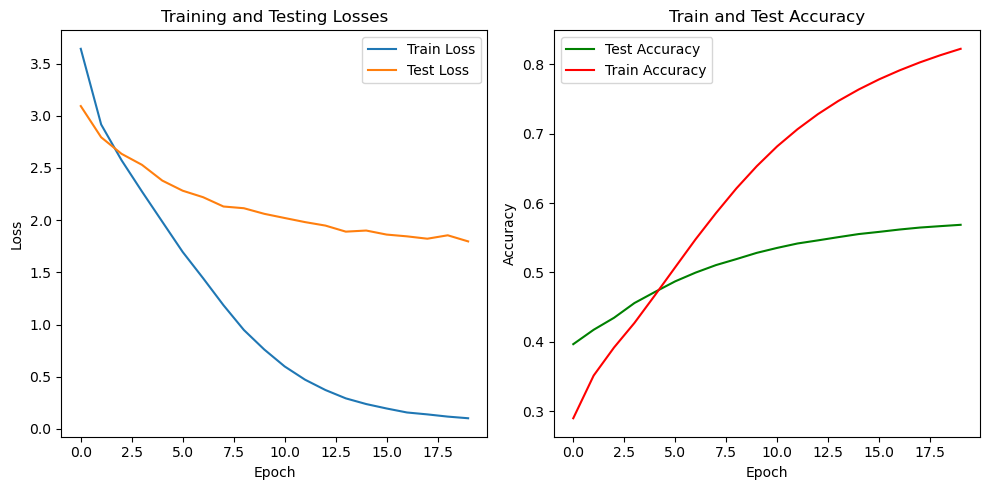

In [53]:
visualize_learning('results.pth')

# Implementation of the ResNet model, with freezing model parameters

In [ ]:
import torchvision.models as models

class ResNet:
    def work(self, output_file_path: str, tuned: bool):
        early_stopping = EarlyStopping(patience=3, verbose=True)

        resnet = models.resnet18(weights='ResNet18_Weights.DEFAULT')
        

        if tuned:
            for param in resnet.parameters():
                param.requires_grad = True
        else:
            for param in resnet.parameters():
                param.requires_grad = False

        num_ftrs = resnet.fc.in_features
        resnet.fc = nn.Linear(num_ftrs, 101) 

        resnet = resnet.to(device)

        criterion = nn.CrossEntropyLoss()
        optimizer = optim.Adam(resnet.parameters(), lr=0.0001)

        results_resnet = {
            'train_losses': [],
            'test_losses': [],
            'test_accuracies': [],
            'train_accuracies': [],
            'early_stopping_epoch': 0,
            'train_predicted_labels': [],
            'train_ground_truth_labels': [],
            'test_predicted_labels': [],
            'test_ground_truth_labels': []
        }

        num_epochs = 20
        for epoch in range(num_epochs):
            resnet.train()
            running_loss = 0.0
            for images, labels in tqdm(trainloader):
                images, labels = images.to(device), labels.to(device)
                optimizer.zero_grad()
                outputs = resnet(images)
                loss = criterion(outputs, labels)
                loss.backward()
                optimizer.step()
                running_loss += loss.item()

                _, predicted = torch.max(outputs, 1)
                results_resnet['train_predicted_labels'].extend(predicted.cpu().numpy())
                results_resnet['train_ground_truth_labels'].extend(labels.cpu().numpy())
            train_loss = running_loss / len(trainloader)
            results_resnet['train_losses'].append(train_loss)

            resnet.eval()
            correct = 0
            total = 0
            test_loss = 0.0
            with torch.no_grad():
                for images, labels in tqdm(testloader):
                    images, labels = images.to(device), labels.to(device)
                    outputs = resnet(images)
                    loss = criterion(outputs, labels)
                    test_loss += loss.item()
                    _, predicted = torch.max(outputs, 1)
                    total += labels.size(0)
                    correct += (predicted == labels).sum().item()

                    results_resnet['test_predicted_labels'].extend(predicted.cpu().numpy())
                    results_resnet['test_ground_truth_labels'].extend(labels.cpu().numpy())

            test_loss /= len(testloader)
            results_resnet['test_losses'].append(test_loss)

            train_accuracy = accuracy_score(results_resnet['train_ground_truth_labels'], results_resnet['train_predicted_labels'])
            test_accuracy = accuracy_score(results_resnet['test_ground_truth_labels'], results_resnet['test_predicted_labels'])

            results_resnet['train_accuracies'].append(train_accuracy)
            results_resnet['test_accuracies'].append(test_accuracy)
            print(f"Epoch {epoch+1}: Train Loss: {train_loss:.4f}, Test Loss: {test_loss:.4f}")
            print(f'Train Accuracy: {train_accuracy * 100:.2f}%, Test Accuracy: {test_accuracy * 100:.2f}%')

            if early_stopping(test_loss):
                results_resnet['early_stopping_epoch'] = epoch
                print("Early stopping")
                break

        torch.save(results_resnet, output_file_path)

# 1.2 Frozen pre-trained ResNet as feature extractor

In [83]:
resnet_freeze_params = ResNet()

In [55]:
resnet_freeze_params.work(output_file_path='results_resnet.pth', tuned=False)

100%|██████████| 82/82 [00:10<00:00,  7.91it/s]


Epoch 1: Train Loss: 3.9433, Test Loss: 3.3456
Train Accuracy: 13.44%, Test Accuracy: 27.50%
Test loss decreased (inf --> 3.345630).  Saving model ...


100%|██████████| 82/82 [00:10<00:00,  8.09it/s]


Epoch 2: Train Loss: 2.9351, Test Loss: 2.5463
Train Accuracy: 24.63%, Test Accuracy: 38.11%
Test loss decreased (3.345630 --> 2.546259).  Saving model ...


100%|██████████| 82/82 [00:09<00:00,  8.36it/s]


Epoch 3: Train Loss: 2.2854, Test Loss: 2.0206
Train Accuracy: 34.85%, Test Accuracy: 46.13%
Test loss decreased (2.546259 --> 2.020564).  Saving model ...


100%|██████████| 82/82 [00:09<00:00,  8.24it/s]


Epoch 4: Train Loss: 1.8376, Test Loss: 1.6582
Train Accuracy: 43.16%, Test Accuracy: 52.48%
Test loss decreased (2.020564 --> 1.658203).  Saving model ...


100%|██████████| 82/82 [00:09<00:00,  8.29it/s]


Epoch 5: Train Loss: 1.5147, Test Loss: 1.3796
Train Accuracy: 49.99%, Test Accuracy: 57.53%
Test loss decreased (1.658203 --> 1.379646).  Saving model ...


100%|██████████| 82/82 [00:09<00:00,  8.41it/s]


Epoch 6: Train Loss: 1.2706, Test Loss: 1.2084
Train Accuracy: 55.33%, Test Accuracy: 61.41%
Test loss decreased (1.379646 --> 1.208404).  Saving model ...


100%|██████████| 82/82 [00:09<00:00,  8.36it/s]


Epoch 7: Train Loss: 1.0884, Test Loss: 1.0539
Train Accuracy: 59.68%, Test Accuracy: 64.57%
Test loss decreased (1.208404 --> 1.053937).  Saving model ...


100%|██████████| 82/82 [00:09<00:00,  8.43it/s]


Epoch 8: Train Loss: 0.9445, Test Loss: 0.9465
Train Accuracy: 63.20%, Test Accuracy: 67.22%
Test loss decreased (1.053937 --> 0.946544).  Saving model ...


100%|██████████| 82/82 [00:09<00:00,  8.26it/s]


Epoch 9: Train Loss: 0.8310, Test Loss: 0.8486
Train Accuracy: 66.16%, Test Accuracy: 69.36%
Test loss decreased (0.946544 --> 0.848625).  Saving model ...


100%|██████████| 82/82 [00:09<00:00,  8.35it/s]


Epoch 10: Train Loss: 0.7406, Test Loss: 0.7703
Train Accuracy: 68.67%, Test Accuracy: 71.19%
Test loss decreased (0.848625 --> 0.770287).  Saving model ...


100%|██████████| 82/82 [00:09<00:00,  8.23it/s]


Epoch 11: Train Loss: 0.6639, Test Loss: 0.7179
Train Accuracy: 70.83%, Test Accuracy: 72.73%
Test loss decreased (0.770287 --> 0.717907).  Saving model ...


100%|██████████| 82/82 [00:10<00:00,  8.15it/s]


Epoch 12: Train Loss: 0.6025, Test Loss: 0.6661
Train Accuracy: 72.68%, Test Accuracy: 74.06%
Test loss decreased (0.717907 --> 0.666120).  Saving model ...


100%|██████████| 82/82 [00:09<00:00,  8.39it/s]


Epoch 13: Train Loss: 0.5510, Test Loss: 0.6189
Train Accuracy: 74.30%, Test Accuracy: 75.25%
Test loss decreased (0.666120 --> 0.618946).  Saving model ...


100%|██████████| 82/82 [00:09<00:00,  8.30it/s]


Epoch 14: Train Loss: 0.5082, Test Loss: 0.5908
Train Accuracy: 75.71%, Test Accuracy: 76.25%
Test loss decreased (0.618946 --> 0.590756).  Saving model ...


100%|██████████| 82/82 [00:09<00:00,  8.26it/s]


Epoch 15: Train Loss: 0.4713, Test Loss: 0.5545
Train Accuracy: 76.96%, Test Accuracy: 77.17%
Test loss decreased (0.590756 --> 0.554473).  Saving model ...


100%|██████████| 82/82 [00:09<00:00,  8.28it/s]


Epoch 16: Train Loss: 0.4368, Test Loss: 0.5345
Train Accuracy: 78.06%, Test Accuracy: 77.97%
Test loss decreased (0.554473 --> 0.534496).  Saving model ...


100%|██████████| 82/82 [00:09<00:00,  8.26it/s]


Epoch 17: Train Loss: 0.4055, Test Loss: 0.5147
Train Accuracy: 79.04%, Test Accuracy: 78.69%
Test loss decreased (0.534496 --> 0.514670).  Saving model ...


100%|██████████| 82/82 [00:09<00:00,  8.28it/s]


Epoch 18: Train Loss: 0.3812, Test Loss: 0.4854
Train Accuracy: 79.94%, Test Accuracy: 79.34%
Test loss decreased (0.514670 --> 0.485432).  Saving model ...


100%|██████████| 82/82 [00:09<00:00,  8.27it/s]


Epoch 19: Train Loss: 0.3553, Test Loss: 0.4635
Train Accuracy: 80.77%, Test Accuracy: 79.93%
Test loss decreased (0.485432 --> 0.463539).  Saving model ...


100%|██████████| 82/82 [00:09<00:00,  8.37it/s]


Epoch 20: Train Loss: 0.3346, Test Loss: 0.4526
Train Accuracy: 81.53%, Test Accuracy: 80.46%
Test loss decreased (0.463539 --> 0.452592).  Saving model ...


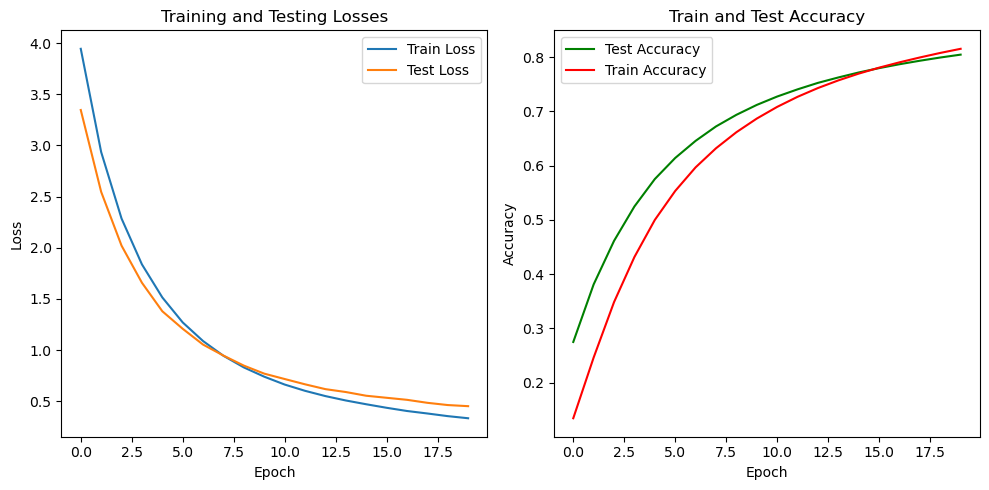

In [56]:
visualize_learning('results_resnet.pth')

# 1.3 Fine-tuned pre-trained ResNet

In [75]:
resnet_tuned_parameters = ResNet()

In [17]:
resnet_tuned_parameters.work(output_file_path='results_resnet_tuned.pth', tuned=True)

100%|██████████| 82/82 [00:06<00:00, 13.36it/s]


Epoch 1: Train Loss: 1.6961, Test Loss: 0.6084
Train Accuracy: 68.94%, Test Accuracy: 89.82%
Test loss decreased (inf --> 0.608384).  Saving model ...


100%|██████████| 82/82 [00:05<00:00, 13.77it/s]


Epoch 2: Train Loss: 0.3184, Test Loss: 0.3194
Train Accuracy: 82.78%, Test Accuracy: 92.03%
Test loss decreased (0.608384 --> 0.319408).  Saving model ...


100%|██████████| 82/82 [00:05<00:00, 13.87it/s]


Epoch 3: Train Loss: 0.0851, Test Loss: 0.2481
Train Accuracy: 88.38%, Test Accuracy: 93.04%
Test loss decreased (0.319408 --> 0.248146).  Saving model ...


100%|██████████| 82/82 [00:06<00:00, 13.23it/s]


Epoch 4: Train Loss: 0.0379, Test Loss: 0.2240
Train Accuracy: 91.25%, Test Accuracy: 93.60%
Test loss decreased (0.248146 --> 0.223972).  Saving model ...


100%|██████████| 82/82 [00:06<00:00, 13.35it/s]


Epoch 5: Train Loss: 0.0199, Test Loss: 0.2052
Train Accuracy: 92.99%, Test Accuracy: 93.92%
Test loss decreased (0.223972 --> 0.205182).  Saving model ...


100%|██████████| 82/82 [00:05<00:00, 13.82it/s]


Epoch 6: Train Loss: 0.0148, Test Loss: 0.2024
Train Accuracy: 94.14%, Test Accuracy: 94.22%
Test loss decreased (0.205182 --> 0.202385).  Saving model ...


100%|██████████| 82/82 [00:05<00:00, 14.02it/s]


Epoch 7: Train Loss: 0.0117, Test Loss: 0.1917
Train Accuracy: 94.97%, Test Accuracy: 94.39%
Test loss decreased (0.202385 --> 0.191663).  Saving model ...


100%|██████████| 82/82 [00:05<00:00, 13.92it/s]


Epoch 8: Train Loss: 0.0078, Test Loss: 0.1890
Train Accuracy: 95.59%, Test Accuracy: 94.59%
Test loss decreased (0.191663 --> 0.188969).  Saving model ...


100%|██████████| 82/82 [00:05<00:00, 13.73it/s]


Epoch 9: Train Loss: 0.0061, Test Loss: 0.1819
Train Accuracy: 96.07%, Test Accuracy: 94.71%
Test loss decreased (0.188969 --> 0.181869).  Saving model ...


100%|██████████| 82/82 [00:06<00:00, 13.43it/s]


Epoch 10: Train Loss: 0.0050, Test Loss: 0.1816
Train Accuracy: 96.46%, Test Accuracy: 94.82%
Test loss decreased (0.181869 --> 0.181575).  Saving model ...


100%|██████████| 82/82 [00:05<00:00, 13.67it/s]


Epoch 11: Train Loss: 0.0050, Test Loss: 0.1810
Train Accuracy: 96.77%, Test Accuracy: 94.90%
Test loss decreased (0.181575 --> 0.180992).  Saving model ...


100%|██████████| 82/82 [00:06<00:00, 13.63it/s]


Epoch 12: Train Loss: 0.0038, Test Loss: 0.1799
Train Accuracy: 97.03%, Test Accuracy: 94.96%
Test loss decreased (0.180992 --> 0.179854).  Saving model ...


100%|██████████| 82/82 [00:05<00:00, 14.19it/s]


Epoch 13: Train Loss: 0.0037, Test Loss: 0.1823
Train Accuracy: 97.26%, Test Accuracy: 94.99%
EarlyStopping counter: 1 out of 3


100%|██████████| 82/82 [00:06<00:00, 13.39it/s]


Epoch 14: Train Loss: 0.0031, Test Loss: 0.1753
Train Accuracy: 97.45%, Test Accuracy: 95.04%
Test loss decreased (0.179854 --> 0.175287).  Saving model ...


100%|██████████| 82/82 [00:05<00:00, 13.95it/s]


Epoch 15: Train Loss: 0.0026, Test Loss: 0.1764
Train Accuracy: 97.62%, Test Accuracy: 95.08%
EarlyStopping counter: 1 out of 3


100%|██████████| 82/82 [00:05<00:00, 14.05it/s]


Epoch 16: Train Loss: 0.0024, Test Loss: 0.1702
Train Accuracy: 97.76%, Test Accuracy: 95.11%
Test loss decreased (0.175287 --> 0.170191).  Saving model ...


100%|██████████| 82/82 [00:05<00:00, 13.83it/s]


Epoch 17: Train Loss: 0.0023, Test Loss: 0.1725
Train Accuracy: 97.89%, Test Accuracy: 95.15%
EarlyStopping counter: 1 out of 3


100%|██████████| 82/82 [00:05<00:00, 13.85it/s]


Epoch 18: Train Loss: 0.0020, Test Loss: 0.1726
Train Accuracy: 98.01%, Test Accuracy: 95.17%
EarlyStopping counter: 2 out of 3


100%|██████████| 82/82 [00:05<00:00, 13.81it/s]


Epoch 19: Train Loss: 0.0020, Test Loss: 0.1710
Train Accuracy: 98.11%, Test Accuracy: 95.19%
EarlyStopping counter: 3 out of 3
Early stopping


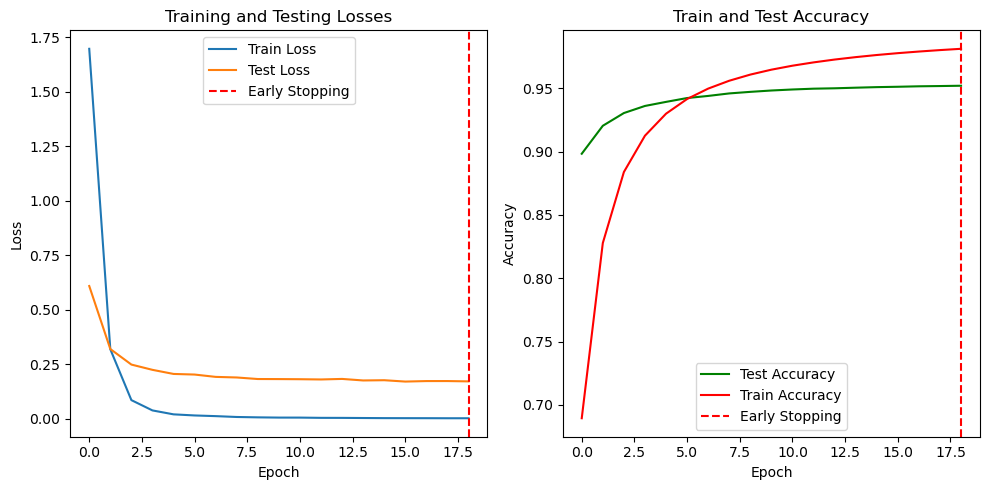

In [20]:
visualize_learning('results_resnet_tuned.pth')

# 2.1 Train/validation results reported in the form of sklearn. metrics.classification_report

In [155]:
from sklearn.metrics import classification_report

def classification_report_CNN(input_file_path: str, table_name: str):
    # Load the saved results
    results = torch.load(input_file_path)

    # Extract train losses, test losses, and test accuracies
    train_ground_truth_labels_plain_3_layer_CNN = results['train_ground_truth_labels']
    train_predicted_labels_plain_3_layer_CNN = results['train_predicted_labels']
    test_ground_truth_labels_plain_3_layer_CNN = results['test_ground_truth_labels']
    test_predicted_labels_plain_3_layer_CNN = results['test_predicted_labels']
    
    # Generate classification reports
    classification_report_train_plain_3_layer_CNN = classification_report(train_ground_truth_labels_plain_3_layer_CNN, train_predicted_labels_plain_3_layer_CNN)
    classification_report_test_plain_3_layer_CNN = classification_report(test_ground_truth_labels_plain_3_layer_CNN, test_predicted_labels_plain_3_layer_CNN)


    # Print or save the classification reports
    print(f"Classification Report for {table_name} (Train):")
    print(classification_report_train_plain_3_layer_CNN)

    print(f"Classification Report for {table_name} (Test):")
    print(classification_report_test_plain_3_layer_CNN)

Result for plain 3 layer CNN model

In [156]:
classification_report_CNN('results.pth', 'Plain 3 layer CNN')

Classification Report for Plain 3 layer CNN (Train):
              precision    recall  f1-score   support

           0       0.70      0.97      0.81      6140
           1       0.88      0.98      0.93      6040
           2       0.82      0.98      0.90      2860
           3       0.88      0.99      0.93     11540
           4       0.95      0.81      0.87       780
           5       0.82      0.99      0.90     11740
           6       0.94      0.67      0.78       560
           7       0.92      0.64      0.75       620
           8       0.74      0.64      0.69       680
           9       0.95      0.66      0.78       800
          10       0.98      0.60      0.74       600
          11       0.93      0.68      0.79       440
          12       0.72      0.88      0.79      1600
          13       0.85      0.84      0.84      1400
          14       0.97      0.62      0.75       560
          15       0.87      0.77      0.82      1180
          16       0.84     

Result for Frozen pre-trained ResNet as feature extractor

In [157]:
classification_report_CNN('results_resnet.pth', "Frozen pre-trained ResNet")

Classification Report for Frozen pre-trained ResNet (Train):
              precision    recall  f1-score   support

           0       0.79      0.94      0.86      6200
           1       0.85      0.85      0.85      5840
           2       0.85      0.94      0.89      2940
           3       0.69      0.97      0.81     11180
           4       0.95      0.87      0.91       720
           5       0.69      0.97      0.81     11320
           6       0.88      0.33      0.47       640
           7       0.89      0.47      0.61       600
           8       0.80      0.67      0.73       660
           9       0.93      0.56      0.70       800
          10       0.85      0.67      0.75       600
          11       0.95      0.69      0.80       480
          12       0.82      0.88      0.85      1840
          13       0.78      0.87      0.82      1460
          14       0.85      0.43      0.57       580
          15       0.88      0.84      0.86      1320
          16       0

Results for Fine-tuned pre-trained ResNet

In [158]:
classification_report_CNN('results_resnet_tuned.pth', "Fine-tuned pre-trained ResNet")

Classification Report for Fine-tuned pre-trained ResNet (Train):
              precision    recall  f1-score   support

           0       0.99      0.99      0.99      5833
           1       0.99      0.99      0.99      5738
           2       0.98      1.00      0.99      2717
           3       0.99      1.00      0.99     10963
           4       0.97      0.99      0.98       741
           5       0.99      1.00      1.00     11153
           6       0.99      0.93      0.96       532
           7       0.99      0.94      0.96       589
           8       1.00      0.97      0.98       646
           9       0.97      0.96      0.96       760
          10       1.00      0.95      0.97       570
          11       1.00      0.95      0.98       418
          12       0.96      0.99      0.98      1520
          13       0.98      0.99      0.98      1330
          14       0.99      0.94      0.97       532
          15       0.99      0.98      0.99      1121
          16    

# 2.3 Train/validation results reported in the form of Learning curves by hand or TensorBoards learning curves

Result for Plain 3-layer CNN

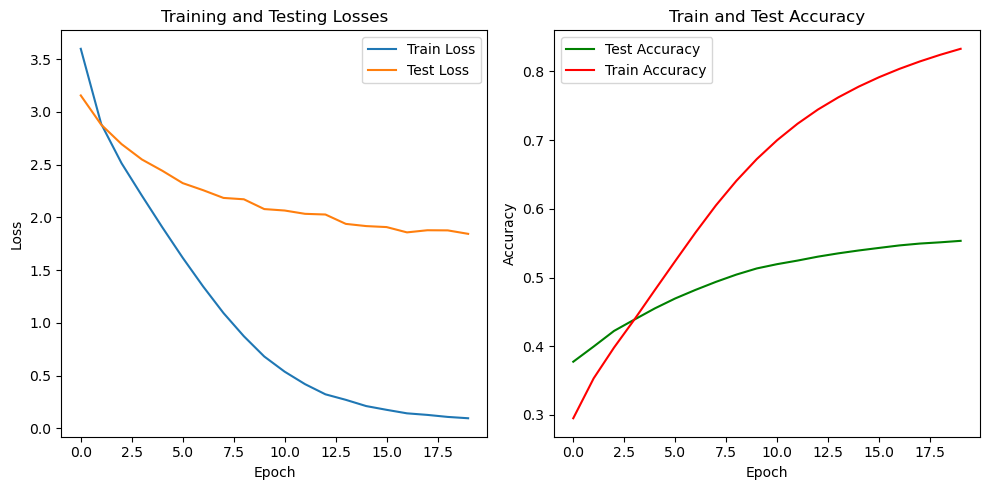

In [163]:
visualize_learning('results.pth')

Result for Frozen pre-trained ResNet as feature extractor

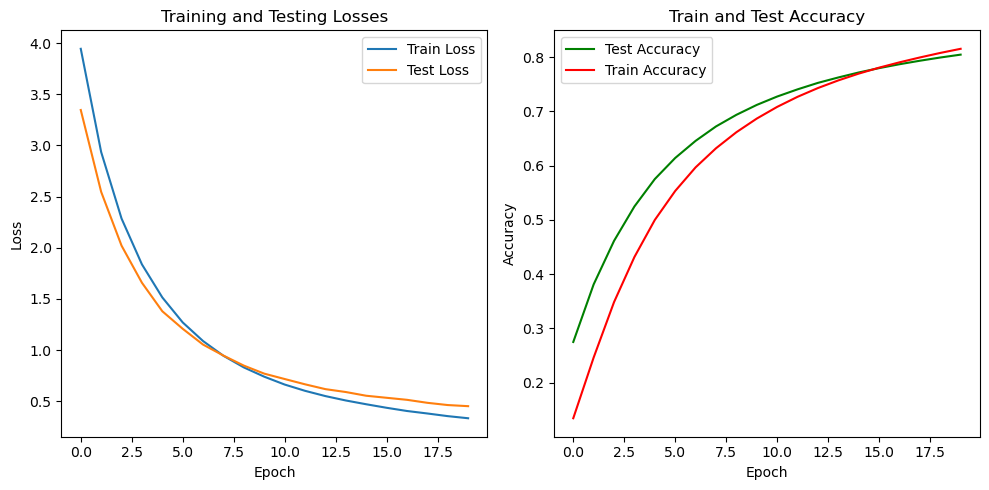

In [164]:
visualize_learning('results_resnet.pth')

Results for Fine-tuned pre-trained ResNet

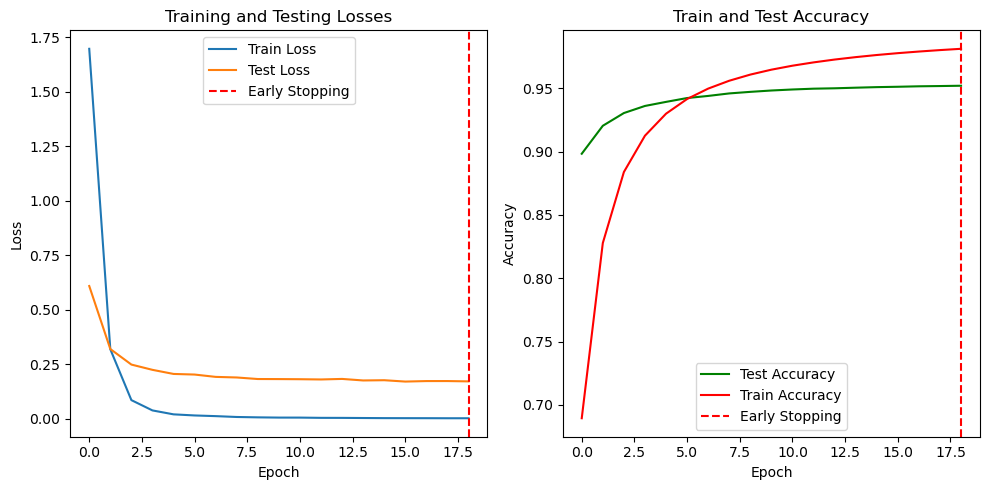

In [166]:
visualize_learning('results_resnet_tuned.pth')

# 2.4 Train/validation results reported in the form of ROC Curve plot

In [ ]:
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
from scipy import interp

def plot_roc(input_file_path):
    results = torch.load(input_file_path)

    for oper in ['train', 'test']:
        test_predicted_labels = results[oper + '_predicted_labels']
        test_ground_truth_labels = results[oper + '_ground_truth_labels']
        test_predicted_labels = torch.tensor(test_predicted_labels).numpy()
        test_ground_truth_labels = torch.tensor(test_ground_truth_labels).numpy()

        num_classes = len(set(test_ground_truth_labels))
        test_ground_truth_labels_bin = label_binarize(test_ground_truth_labels, classes=range(num_classes))
        test_predicted_labels_bin = label_binarize(test_predicted_labels, classes=range(num_classes))

        fpr = dict()
        tpr = dict()
        roc_auc = dict()
        for i in range(num_classes):
            fpr[i], tpr[i], _ = roc_curve(test_ground_truth_labels_bin[:, i], test_predicted_labels_bin[:, i])
            roc_auc[i] = auc(fpr[i], tpr[i])

        fpr["micro"], tpr["micro"], _ = roc_curve(test_ground_truth_labels_bin.ravel(), test_predicted_labels_bin.ravel())
        roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

        plt.figure(figsize=(20, 20))
        plt.plot(fpr["micro"], tpr["micro"], label='micro-average ROC curve (area = {0:0.2f})'
                ''.format(roc_auc["micro"]), color='deeppink', linestyle=':', linewidth=4)

        for i in range(num_classes):
            plt.plot(fpr[i], tpr[i], lw=2, label='ROC curve of class {0} (area = {1:0.2f})'
                    ''.format(i, roc_auc[i]))

        plt.plot([0, 1], [0, 1], 'k--', lw=2)
        plt.xlim([0.0, 1.0])
        plt.ylim([0.0, 1.05])
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title('ROC Curve for Multiclass Classification ' + oper)
        plt.legend(loc="best")
        plt.show()
        

Result for Plain 3-layer CNN

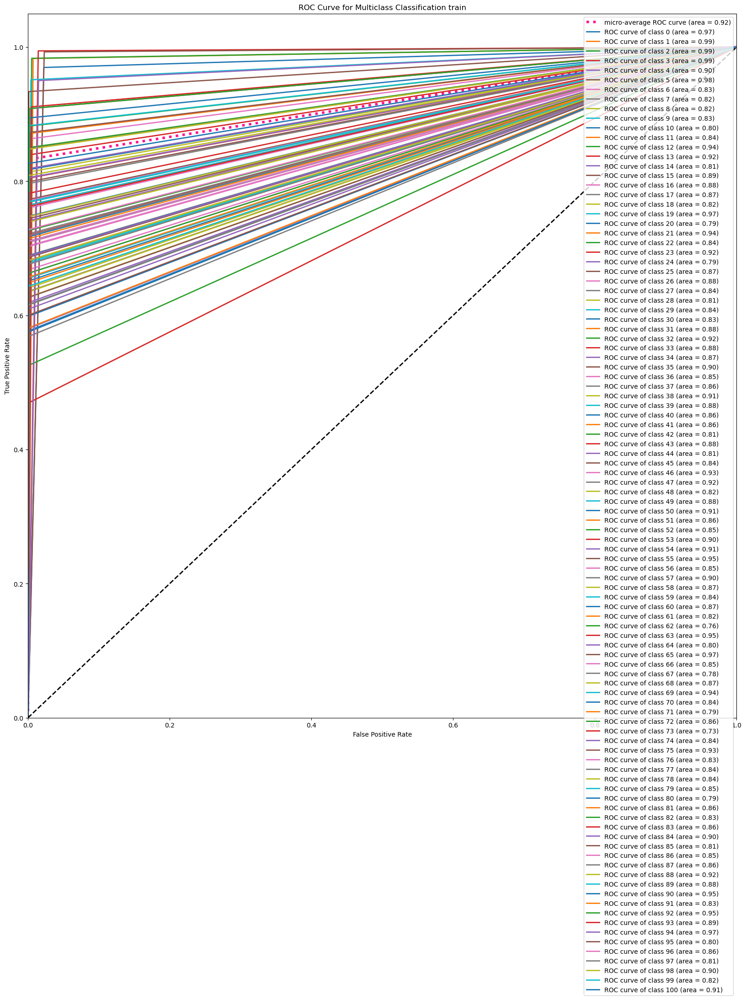

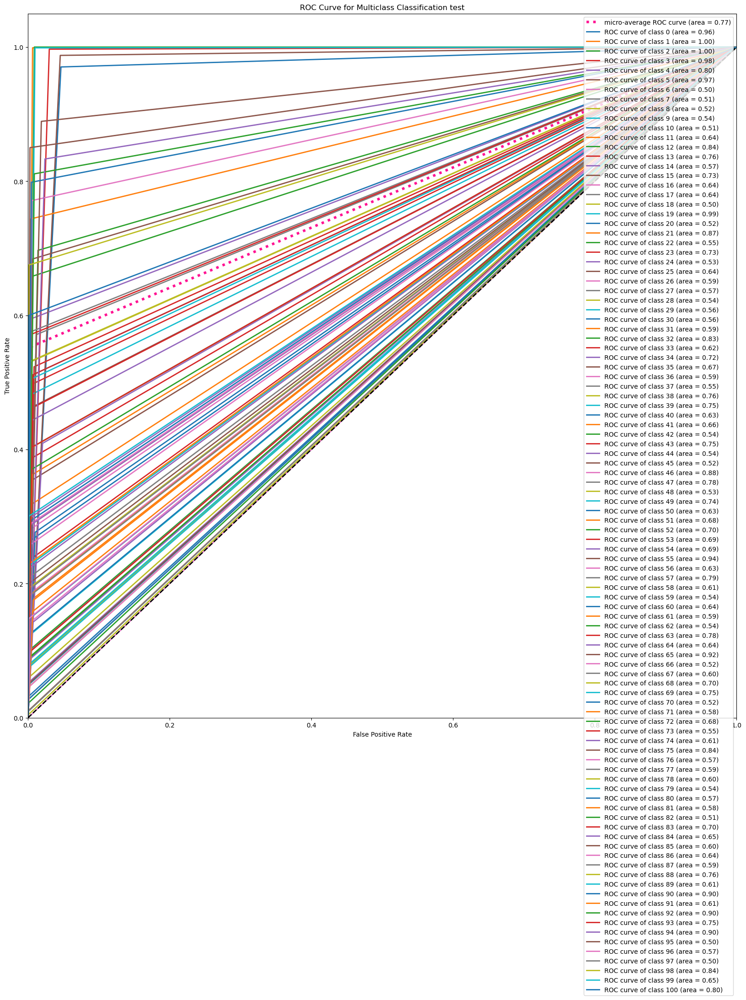

In [168]:
plot_roc('results.pth')

Result for Frozen pre-trained ResNet as feature extractor

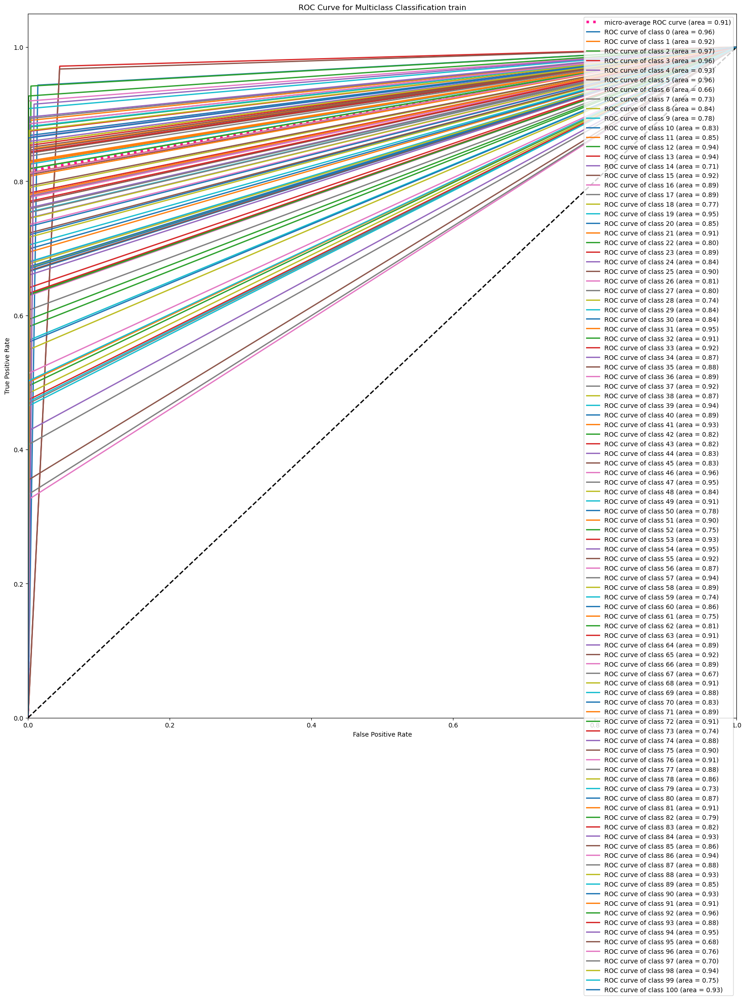

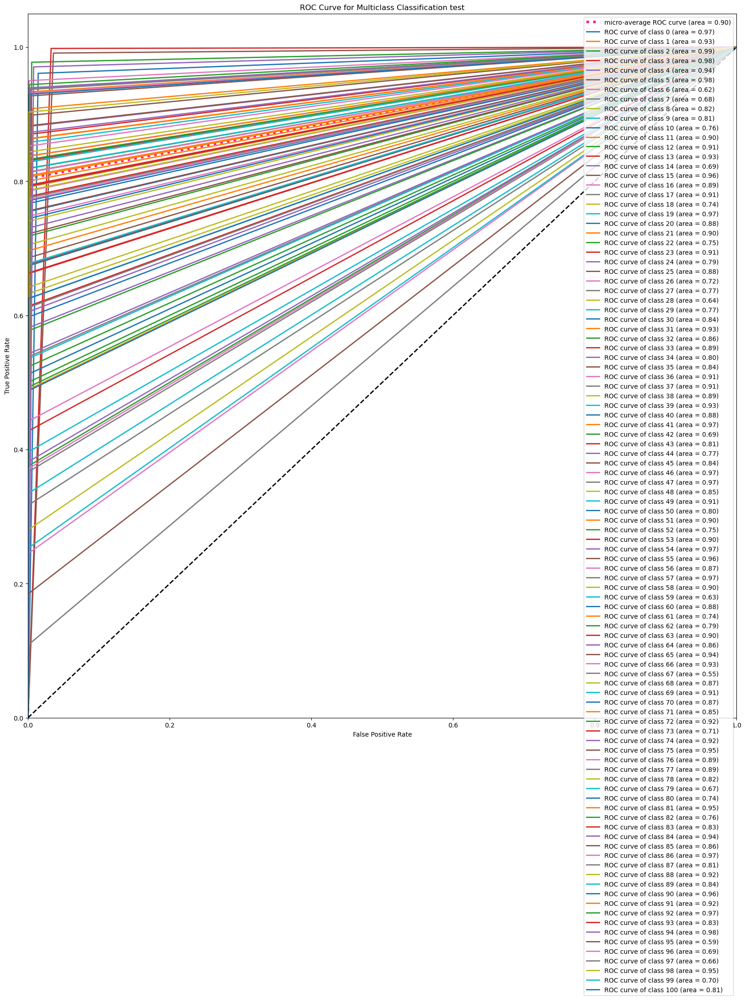

In [169]:
plot_roc('results_resnet.pth')

Results for Fine-tuned pre-trained ResNet

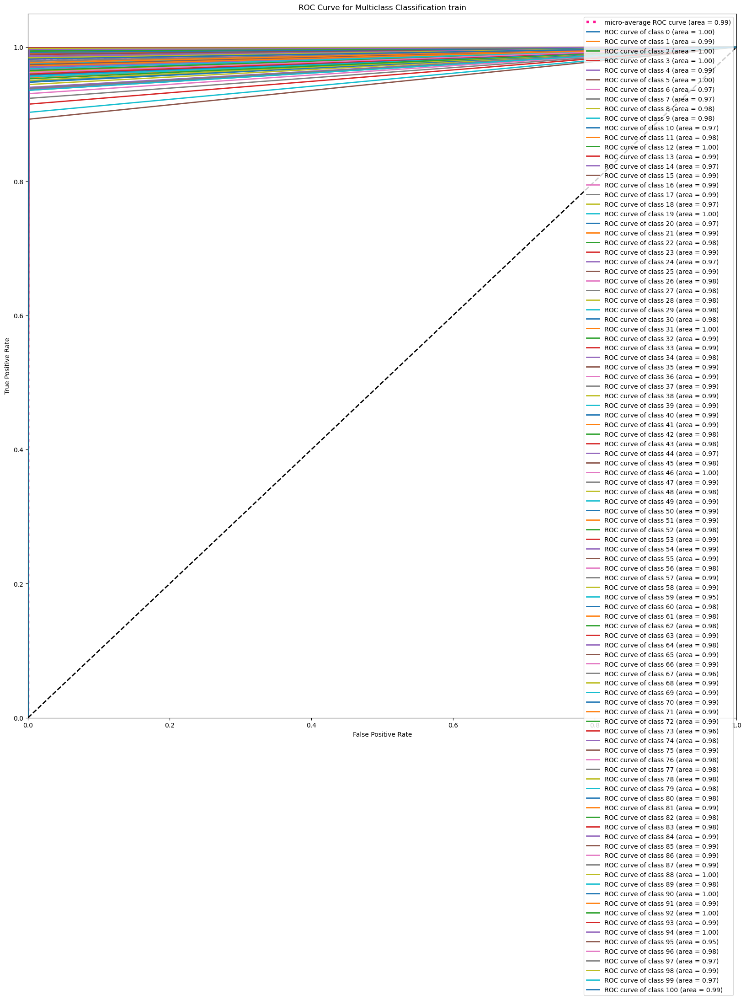

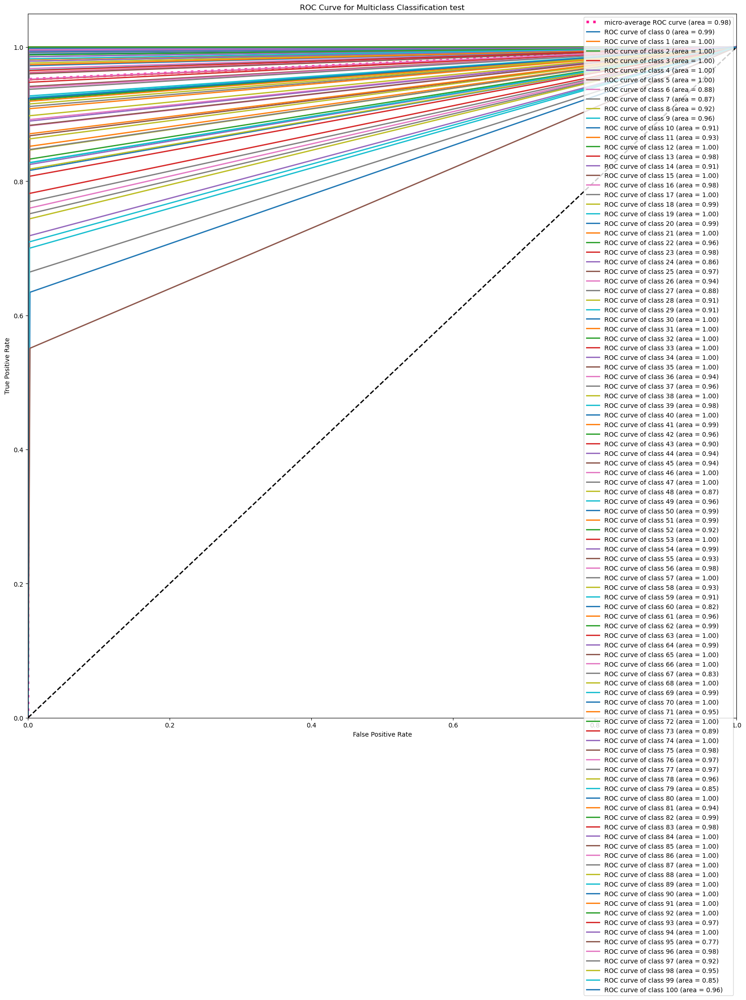

In [170]:
plot_roc('results_resnet_tuned.pth')

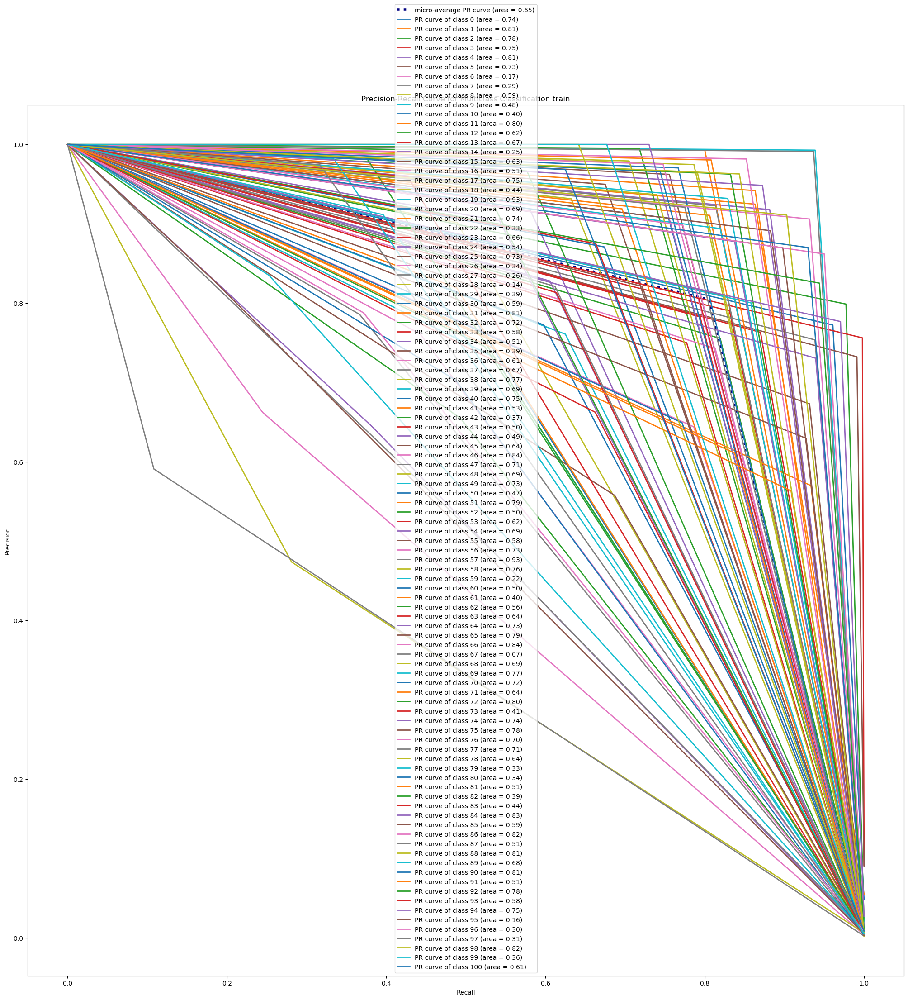

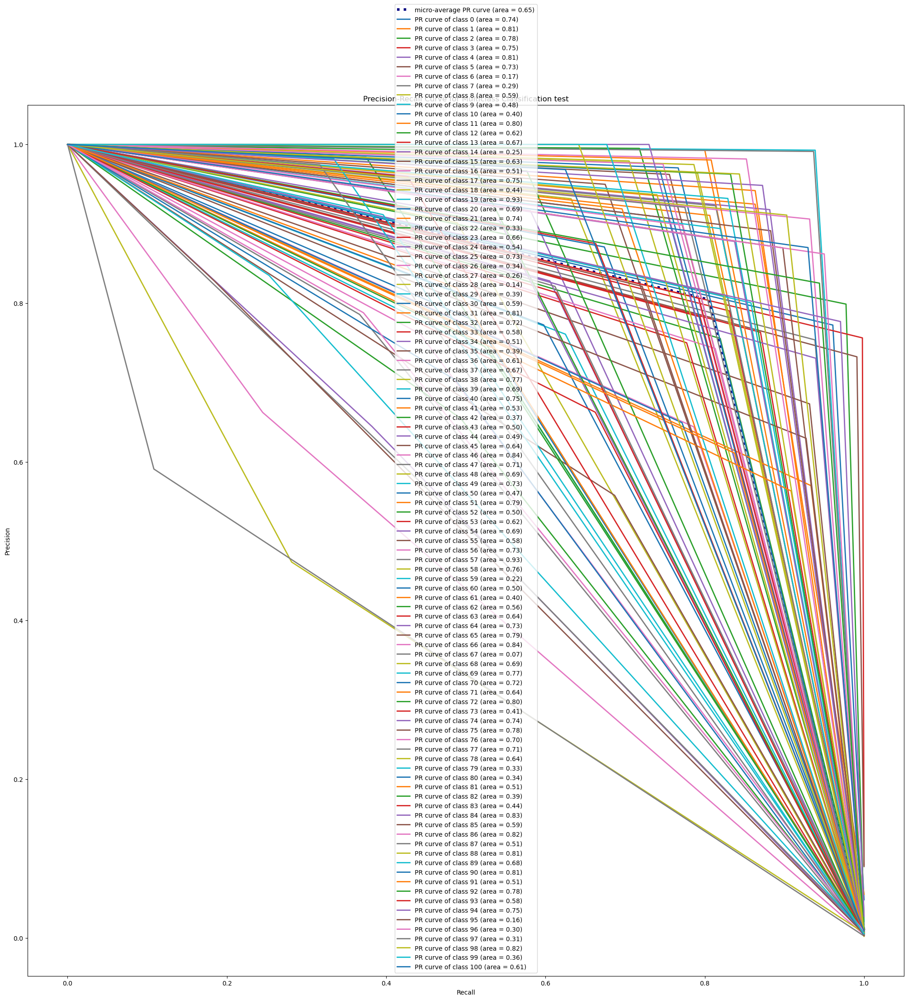

In [173]:
plot_auc_prc('results_resnet.pth')

Results for Fine-tuned pre-trained ResNet

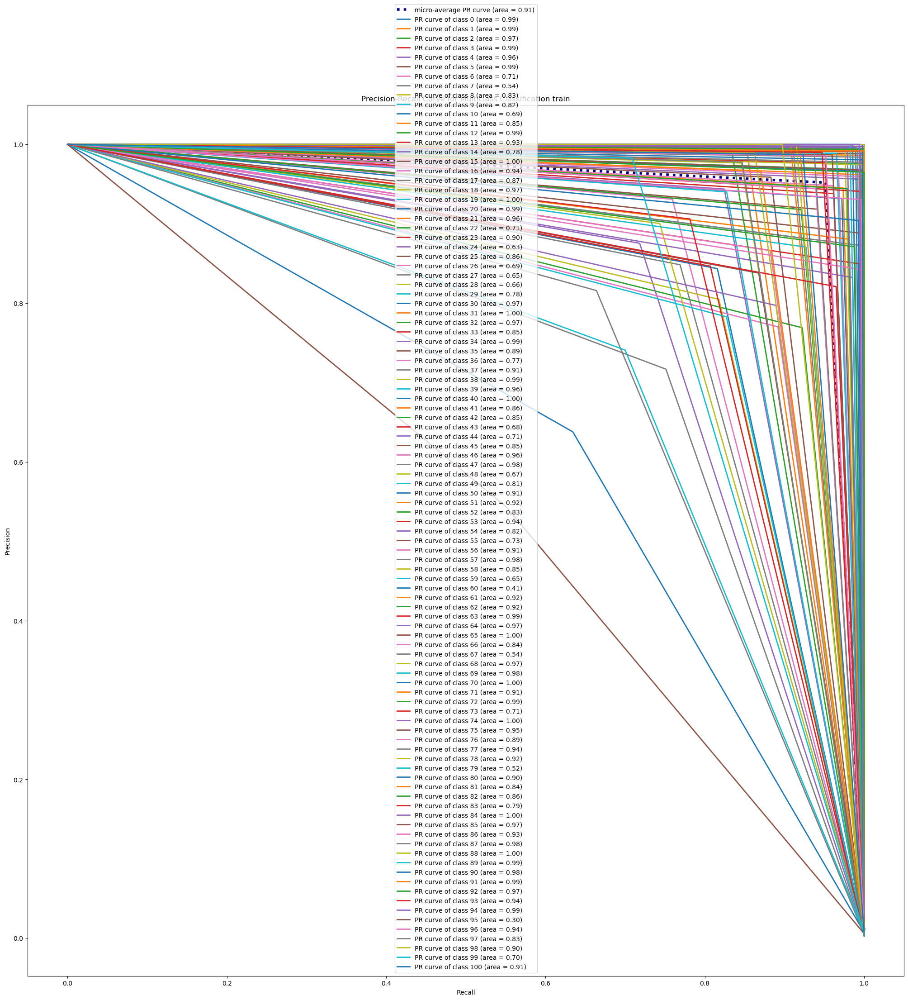

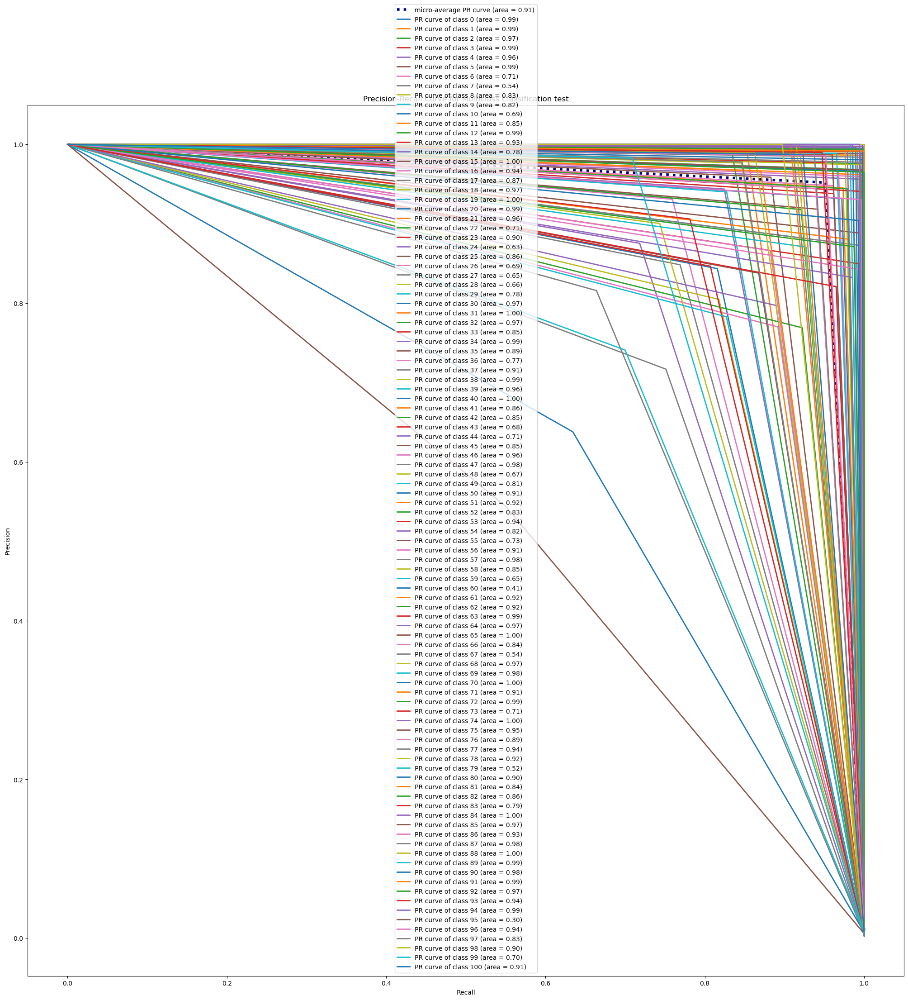

In [174]:
plot_auc_prc('results_resnet_tuned.pth')

# 3. Visualize filters and corresponding feature maps of the first and second Conv2d layers 

In [ ]:
import math

def visualize_filters_and_feature_maps(model_name, model):
    # Load one batch of testing images
    images, labels = next(iter(testloader))
    images = images.to(device)  
    
    idx = 3
    img = images[idx].cpu().permute(1, 2, 0).numpy()

    plt.imshow(img)
    plt.axis('off')
    plt.show()

    if model_name == 'CNN':
        conv_layers = [model.conv1, model.conv2]
    elif model_name == 'freezed':
        conv_layers = [model.layer1[0].conv1, model.layer2[0].conv1]
    elif model_name == 'tuned':
        conv_layers = [model.layer1[0].conv1, model.layer2[0].conv1]

    for conv_layer in conv_layers:
        weights = conv_layer.weight.data.cpu().numpy()  # Move weights to CPU and convert to NumPy array
        w = weights
        fig = plt.figure(figsize=(40, 30))
        columns = min(10, w.shape[0])  # Number of filters
        rows = 2

        for i in range(0, columns * rows):
            fig.add_subplot(rows, columns, i + 1)
            if (i % 2) == 0:
                plt.imshow(X=weights[int(i / 2)][0])
                plt.axis("off")
                plt.title(f"1st layer filter weights {i//2}")
            else:
                c = cv2.filter2D(img, -1, weights[int((i - 1) / 2)][0])
                plt.imshow(cv2.cvtColor(c, cv2.COLOR_BGR2RGB))
                plt.axis("off")
                plt.title(f"Img filtered by {i//2}")

        plt.suptitle("Resnet weights")
        plt.tight_layout()
        plt.show()


Results for plain 3 layer CNN

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


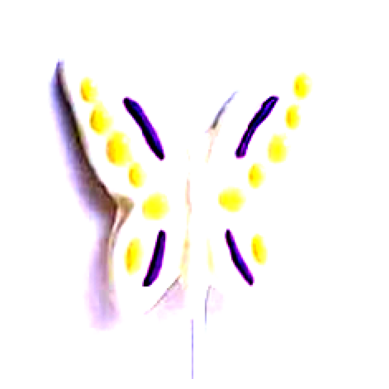

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


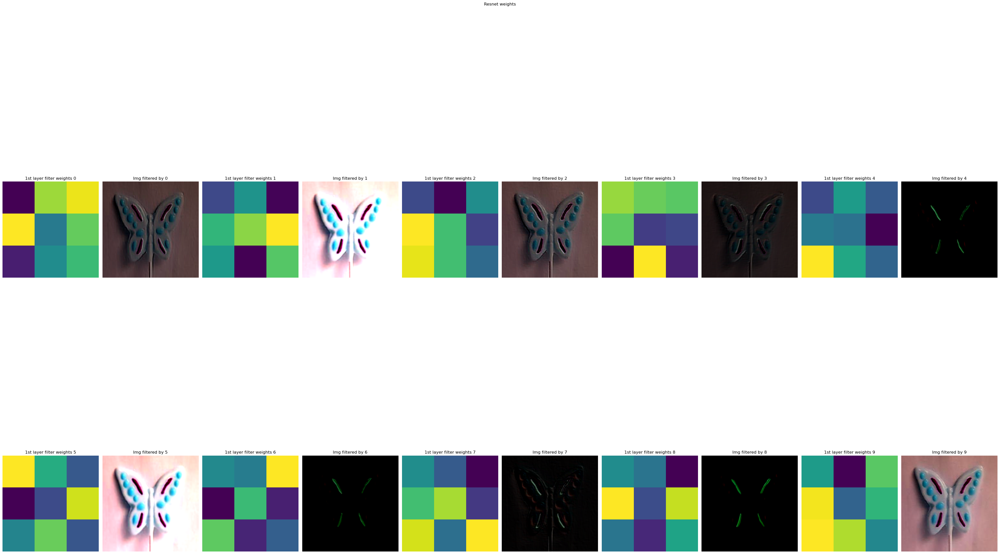

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

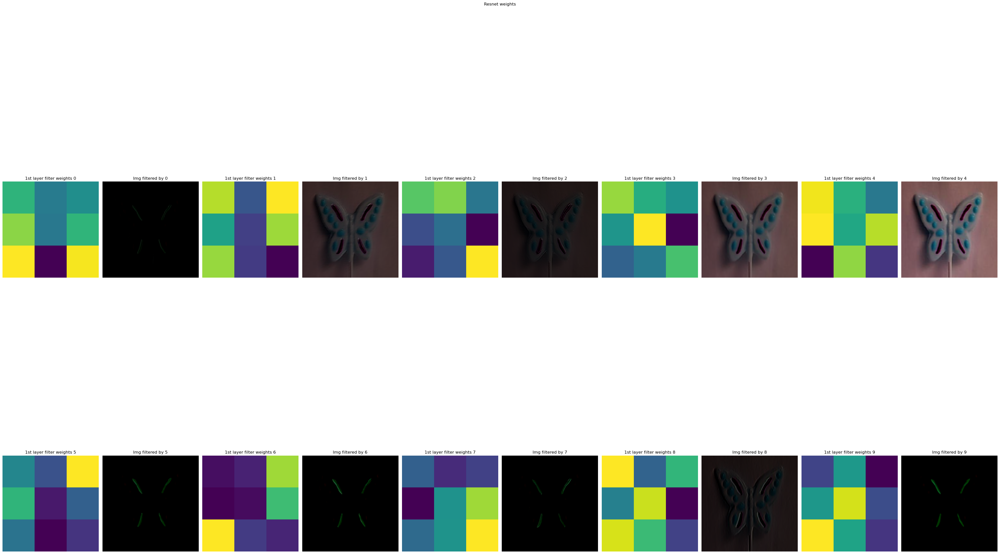

In [180]:
modelCNN.eval()
visualize_filters_and_feature_maps("CNN", modelCNN)

In [ ]:
resnet_freezed = models.resnet18(weights='ResNet18_Weights.DEFAULT')

for param in resnet_freezed.parameters():
    param.requires_grad = False

num_ftrs = resnet_freezed.fc.in_features
resnet_freezed.fc = nn.Linear(num_ftrs, 101)  

resnet_freezed = resnet_freezed.to(device)
resnet_freezed.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

Results for freezed pretrained Resnet as feature extractor

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


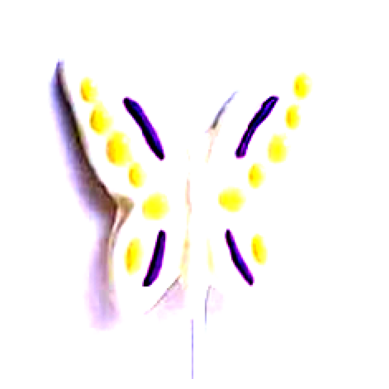

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


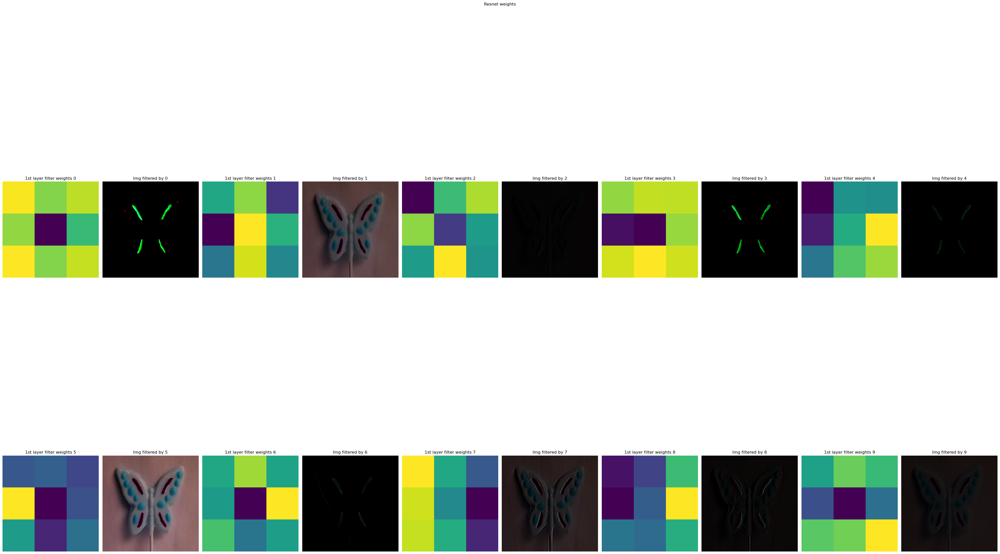

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

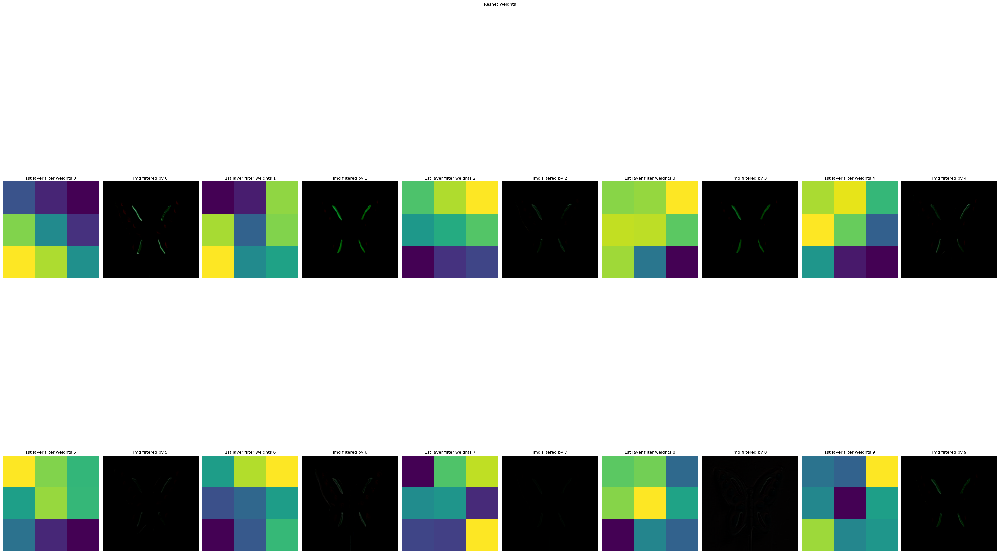

In [182]:
visualize_filters_and_feature_maps("freezed", resnet_freezed)

In [ ]:
resnet_tuned = models.resnet18(weights='ResNet18_Weights.DEFAULT')

for param in resnet_tuned.parameters():
    param.requires_grad = True

num_ftrs = resnet_tuned.fc.in_features
resnet_tuned.fc = nn.Linear(num_ftrs, 101)

resnet_tuned = resnet_tuned.to(device)

resnet_tuned.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

Result for tuned pretrained Resnet 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


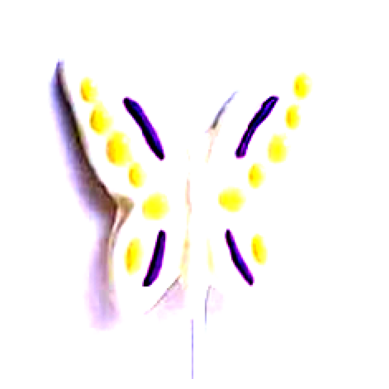

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


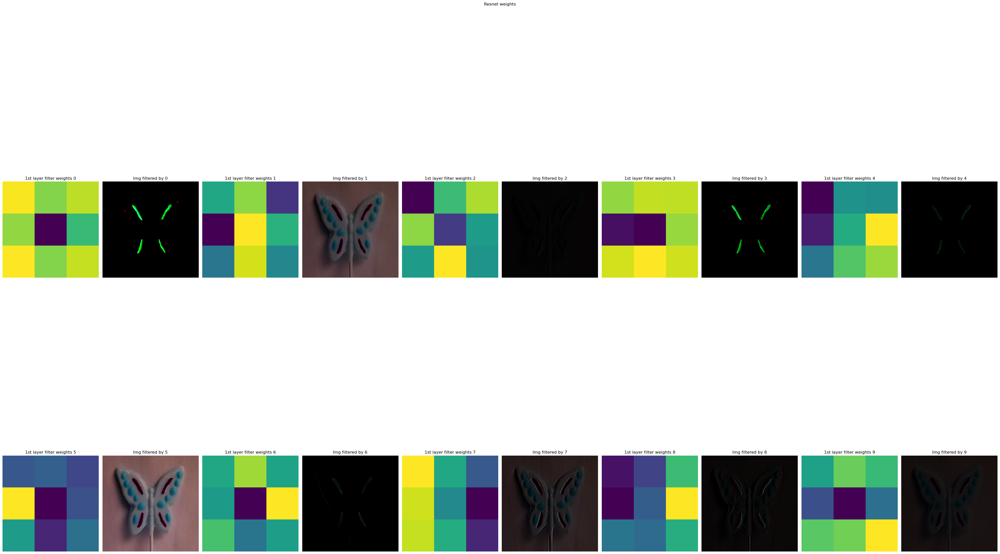

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

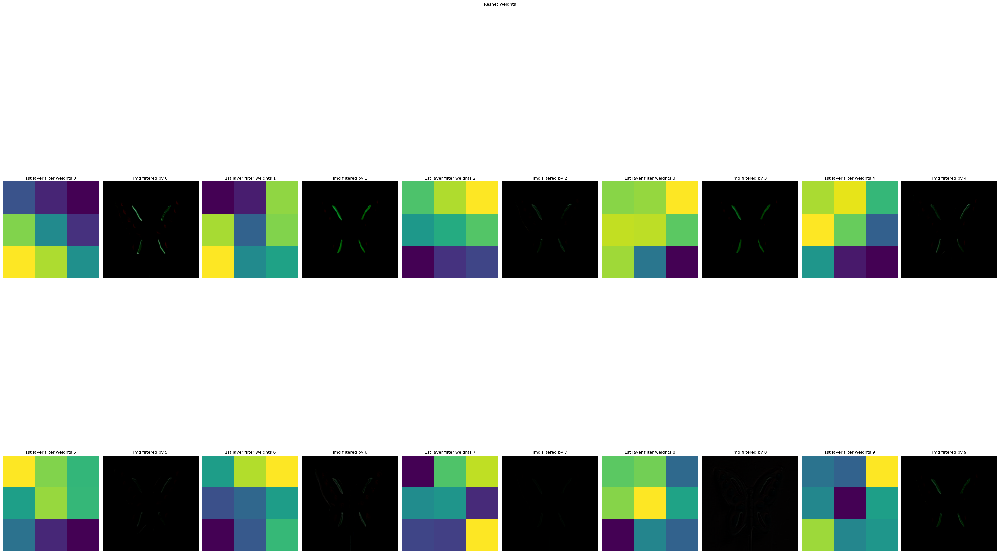

In [184]:
visualize_filters_and_feature_maps("tuned", resnet_tuned)

# Conclusion

As can be seen from the graphs of Learning curves, the CNN model performed the worst, at the same time leading to overfitting. The frozen pretrained ResNet model showed 25% better accuracy on test data. Next, the pretrained tuned model showed the best results with an accuracy of 95% on the test data.\
This happened due to several reasons: the small size of the dataset, where a total of 9000 images were given for the 101 classes present, and the insufficient complexity of the architecture of the CNN model.